In [1]:
!pip install fire cython

# Prepare data and load pre-generated features

In [1]:
import sys
import os

# Change the path here:
sys.path.append(os.path.abspath("./cocoapi-master/PythonAPI"))

import json
import skimage.io as io
import matplotlib.pyplot as plt

from fire import Fire
from pycocotools.coco import COCO
import matplotlib.pyplot as plt
import os.path as osp
import numpy as np


In [2]:

# Change the path here:
data_root='dataset/annotations'
task='instances'
data_type='train2017'

coco = COCO(f'{data_root}/captions_{data_type}.json')
coco_instance = COCO(f'{data_root}/instances_{data_type}.json')
coco_stuff = COCO(f'{data_root}/stuff_{data_type}.json')

# image features
with open(f'features/vit_L_14_336px_imgs_{data_type}.json', 'r') as f:
    imgs_feature = json.load(f)

# caption features
with open(f'features/vit_L_14_336px_captions_{data_type}.json', 'r') as f:
    caps_feature = json.load(f)



# instances
# with open('features/vit_L_14_336px_stuff_category.json', 'r') as f:instance_features
#     cat_features = json.load(f)



# if __name__ == '__main__':
#     Fire(main)

loading annotations into memory...
Done (t=0.44s)
creating index...
index created!
loading annotations into memory...
Done (t=8.51s)
creating index...
index created!
loading annotations into memory...
Done (t=7.08s)
creating index...
index created!


In [3]:

# instances
with open('features/vit_L_14_336px_instances_category.json', 'r') as f:
    instance_features = json.load(f)


In [4]:

img_id = coco.getImgIds()[0]
img = coco.loadImgs(
    img_id
)[0]



def get_instance_list(img_id):
    """This function is used to retrieve instance list"""
    
    anns = coco_instance.loadAnns(
        coco_instance.getAnnIds(imgIds=img_id)
    )
    # coco.showAnns(anns)
    ret = set([
        cat["name"] for cat in coco_instance.loadCats([a["category_id"] for a in anns])
    ])
    
    return ret
    
# plt.imshow(
#     io.imread(img['coco_url'])
# )
# anns = coco_instance.loadAnns(
#     coco_instance.getAnnIds(imgIds=img_id)
# )
# coco.showAnns(anns)
# set([
#     cat["name"] for cat in coco_instance.loadCats([a["category_id"] for a in anns])
# ])

# FAISS

In [ ]:
!pip install faiss-gpu

In [1]:
import faiss
import numpy as np
import time

## Prepare the code for similarity search

This will run four search methods: 

1) IndexFlatL2: measures the L2 (or Euclidean) distance between all given points between our query vector, and the vectors loaded into the index. It’s simple, very accurate, but not too fast.

2) IndexIVFFlat:

3) IndexIVFFlat+n_probe: If approximate search with IndexIVFFlat returns suboptimal results, we can improve accuracy by increasing the search scope. We do this by increasing the nprobe attribute value — which defines how many nearby cells to search.

4) Product Quantization (PQ)

#Instruction: 
replace the randomly generated embeddings with our MSCOCO embeddings and run the following code.

Also has PCA reduction option.

it will generate K indexes of the K nearest embeddings.

In [6]:
import faiss
import numpy as np
import time

# from api import *


# h: hidden dimension
# query: encoded input (can be image/text) [#number of query, h]
# database: encoded database  [#number of samples in database, h]

# res = faiss_search(query, database)


def faiss_search(query, database, distance_metric="l2", k=10, method='l2', use_PCA=False, 
                 use_GPU=False, dim_PCA=256, 
                 n_partitions=50, n_probe=10,
                 n_centroids_pq = 8, n_bits_pq = 8
                 ):
    """ Similarity search with Faiss
    Parameters
    ----------
    k: int
      number of k nearest neighbors.
    method: str
      name for search methods ['l2', 'ivf', 'ivf_probe','pq']
    dim_PCA: int
      embedding dim after PCA
    n_partitions: int
      specify how many partitions (Voronoi cells) we’d like our index to have for Inverted File Index (IVF) index
    n_probe: int
      increase the number of nearby cells to search too with n_probe for Inverted File Index (IVF) index
    n_centroids_pq: int
      number of centroid IDs in final compressed vectors for PQ (Product quantization for nearest neighbor search)
    n_bits_pq: int
      number of bits in each centroid for PQ (Product quantization for nearest neighbor search)
    Returns
    -------
    I: indexes of top-k neighbors
    time(s): time used for search
    D: raw distances between the neighbors and the queries
    """
    emb_texts = database
    emb_images = query
    d = emb_texts.shape[1]
    # assert method in ['l2','ivf','ivf_probe','pq'], f"{method} method not supported"

    if use_PCA:
        # PCA reduction
        mat = faiss.PCAMatrix(d, dim_PCA)
        mat.train(emb_texts)
        emb_texts = mat.apply_py(emb_texts)
        emb_images = mat.apply_py(emb_images)

        d = dim_PCA

    # search_methods = ['l2', 'ivf', 'ivf_probe', 'pq']
    
    
    # search_methods = ['l2', 'ivf', 'ivf_probe', 'pq']
    if distance_metric == 'l2':
        index = faiss.IndexFlatL2(d) 
    elif distance_metric == 'inner':
        index = faiss.IndexFlatIP(d) 

    if method == 'exact':
        #index = faiss.IndexFlatL2(d)   # build the index
        index.add(emb_texts)                  # add vectors to the index
        
    elif method == 'ivf':
        #quantizer = faiss.IndexFlatL2(d)
        index = faiss.IndexIVFFlat(index, d, n_partitions)
        index.train(emb_texts)
        assert index.is_trained
        index.add(emb_texts)

    elif method == 'ivf_probe':
        
        #quantizer = faiss.IndexFlatL2(d)
        index = faiss.IndexIVFFlat(index, d, n_partitions)
        index.train(emb_texts)
        assert index.is_trained
        index.add(emb_texts)
        # increase the number of nearby cells to search too with nprobe.
        index.nprobe = n_probe

    elif method == 'pq':
        #quantizer = faiss.IndexFlatL2(d)  # we keep the same L2 distance flat index
        index = faiss.IndexIVFPQ(index, d, n_partitions, n_centroids_pq, n_bits_pq)
        index.train(emb_texts)
        index.add(emb_texts)
        index.nprobe = n_probe  # align to previous IndexIVFFlat nprobe value


    if use_GPU:
        res = faiss.StandardGpuResources()
        index = faiss.index_cpu_to_gpu(res, 0, index)

    # search
    print(index.ntotal, 'number of embeddings in the database',
            'using method:', method)
    t1 = time.perf_counter()
    D, I = index.search(emb_images, k)
    t2 = time.perf_counter()
    # print('time taken to search:',t2-t1)
    # print(I[:3])                  # indexes of words/sentence, sorted by increasing distance
    # print(D.shape)               # floating-point matrix with the corresponding squared distances.
    return {
        "result": I,
        "time": t2 - t1,
        "raw_distance": D
    }




# Use Caption Feat to Query Image Feat

In [ ]:
caps_feature_flat = np.array(list(caps_feature.values())).astype('float32')
caps_feature_keys = list(caps_feature.keys())

print(caps_feature_flat.shape)

## Prepare data and model

In [8]:
import os
import clip
import torch

# Load pre-generated features
imgs_feature_flat = np.array(list(imgs_feature.values())).astype('float32')
imgs_feature_keys = list(imgs_feature.keys())
print("Image feature is ready: ", imgs_feature_flat.shape)

# Load CLIP model
CLIP_DEVICE = "cuda"
CLIP_MODEL, CLIP_PREPROCESS = clip.load('ViT-L/14@336px', device=CLIP_DEVICE)
print("CLIP model is ready.")



Image feature is ready:  (118287, 768)
CLIP model is ready.


In [9]:
def draw_image(ax, img_id):
    # Load the image
    img_info = coco.loadImgs(int(img_id))[0]
    image_folder = "dataset/{}".format(data_type)
    img_path = osp.join(image_folder, img_info["file_name"])

    # Draw figure
    ax.imshow(plt.imread(img_path))
    ax.set_xticks([])
    ax.set_yticks([])


In [10]:
def get_text_feat(text='a cat', device=CLIP_DEVICE):
    text = clip.tokenize(text).to(device)
    with torch.no_grad():
        text_features = CLIP_MODEL.encode_text(text).cpu().numpy()
    return text_features

def caption_to_image(text, method="l2", d="l2", k=5):
    text_feat = get_text_feat(text)

    res = faiss_search(
        query=text_feat.astype('float32'), 
        database=imgs_feature_flat, 
        k=k, 
        method=method,
        distance_metric=d
    )
    
    print("\n=== Cap->Img Retrivial Result Using {} Method".format(method))
    
    result_in_raw_index = res["result"]
    assert result_in_raw_index.shape[0] == 1
    result_in_raw_index = result_in_raw_index[0]
    
    fig, axes = plt.subplots(1, len(result_in_raw_index), figsize=(5 + k * 5, 10))
    
    for count, res_raw_index in enumerate(result_in_raw_index):
        
        # Original index in captions_feats
        rew_original_index = imgs_feature_keys[res_raw_index]
        
        ax = axes[count]
        draw_image(ax, rew_original_index)
        title="Retrivial Result {}/{} Distance: {:.2f} ".format(
                count + 1, len(result_in_raw_index),
                res["raw_distance"][0][count])
        ax.set_title(title)
    

118287 number of embeddings in the database using method: ivf_probe

=== Cap->Img Retrivial Result Using ivf_probe Method


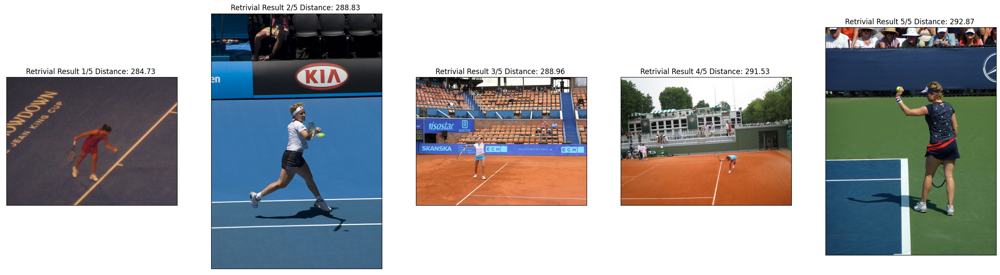

In [17]:
caption_to_image("a woman running across a tennis court so she can hit the ball", "ivf_probe", d="l2")

118287 number of embeddings in the database using method: ivf_probe

=== Cap->Img Retrivial Result Using ivf_probe Method


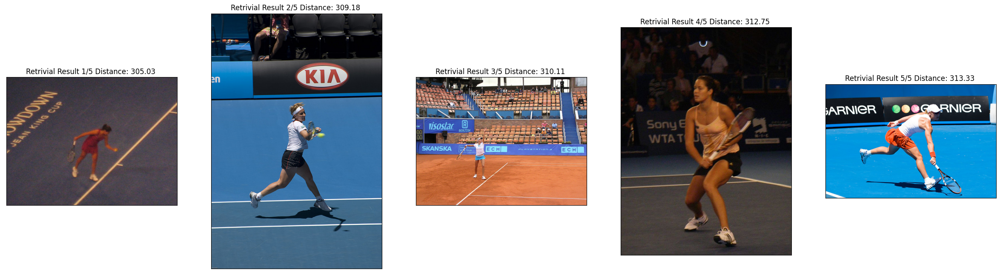

In [18]:
caption_to_image("a woman running across a basketball court so she can hit the ball", "ivf_probe", d="l2")

118287 number of embeddings in the database using method: ivf_probe

=== Cap->Img Retrivial Result Using ivf_probe Method


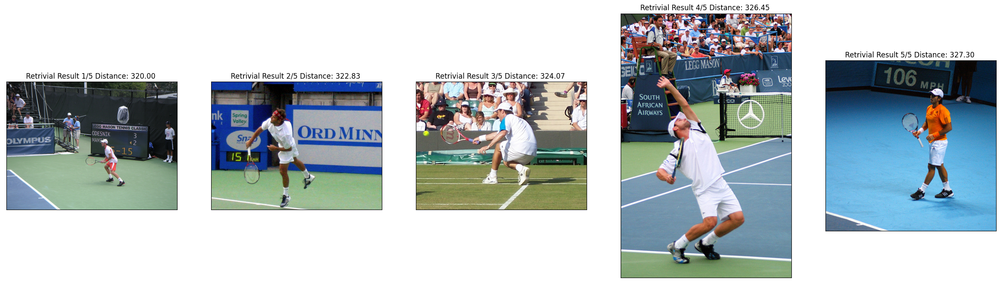

In [19]:
caption_to_image("a man running across a basketball court so he can hit the ball", "ivf_probe", d="l2")

118287 number of embeddings in the database using method: pq

=== Img->Img Retrivial Result Using pq Method
118287 number of embeddings in the database using method: pq

=== Img->Img Retrivial Result Using pq Method


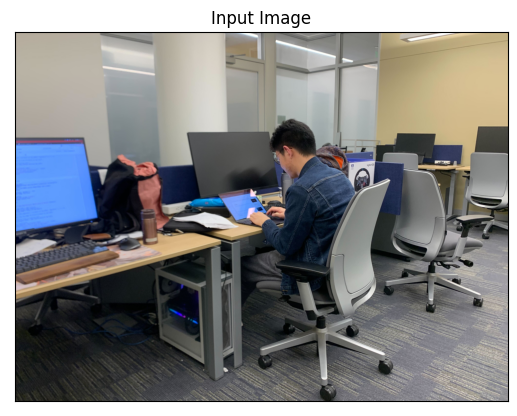

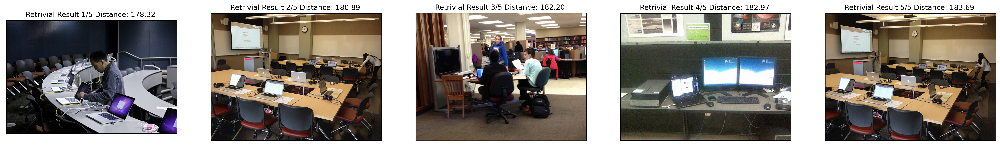

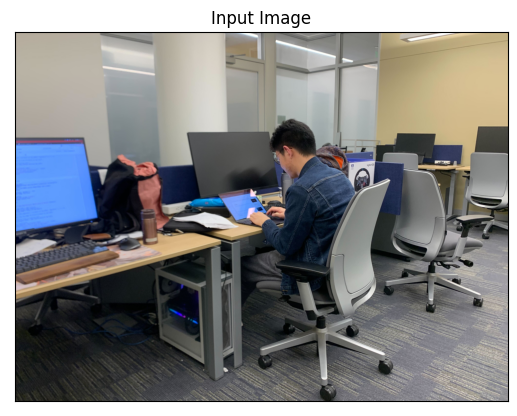

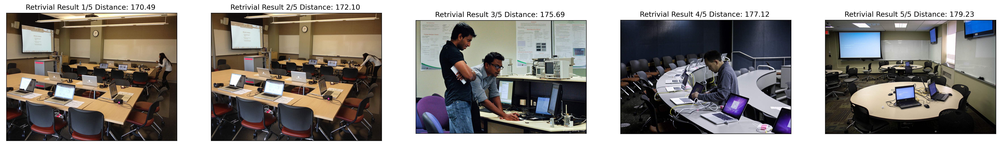

In [11]:
from PIL import Image

def get_image_feat(img_path):
    image = CLIP_PREPROCESS(Image.open(img_path)).unsqueeze(0).to(CLIP_DEVICE)
    with torch.no_grad():
        img_features = CLIP_MODEL.encode_image(image).cpu().numpy()
    return img_features
    
def image_to_image(img_path, method="l2", k=5, distance="l2"):
    plt.imshow(plt.imread(img_path))
    plt.xticks([])
    plt.yticks([])
    plt.title("Input Image")
    
    img_feat = get_image_feat(img_path)

    res = faiss_search(
        query=img_feat.astype('float32'), 
        database=imgs_feature_flat, 
        k=k, 
        method=method,
        distance_metric=distance
    )
    
    print("\n=== Img->Img Retrivial Result Using {} Method".format(method))
    
    result_in_raw_index = res["result"]
    assert result_in_raw_index.shape[0] == 1
    result_in_raw_index = result_in_raw_index[0]
    
    fig, axes = plt.subplots(1, len(result_in_raw_index), figsize=(5 + k * 5, 10), dpi=300)
    
    for count, res_raw_index in enumerate(result_in_raw_index):
        
        # Original index in captions_feats
        rew_original_index = imgs_feature_keys[res_raw_index]
        
        ax = axes[count]
        draw_image(ax, rew_original_index)
        title="Retrivial Result {}/{} Distance: {:.2f} ".format(
                count + 1, len(result_in_raw_index),
                res["raw_distance"][0][count])
        ax.set_title(title)
        
        
image_to_image("IMG_3240.jpg", "pq")
plt.figure()
image_to_image("IMG_3240.jpg", "pq", distance="inner")
# plt.figure()
# image_to_image("IMG_3240.jpg", "ivf_probe")
# plt.figure()
# image_to_image("IMG_3240.jpg", "pq")

(591753, 768)
591753 number of embeddings in the database using method: pq

=== Img->Cap Retrivial Result Using pq Method
Img->Cap Retrivial 1/5: Distance 283.857, Retrivial Caption:
	This business minded calico seems to be letting the paper work pile up.

Img->Cap Retrivial 2/5: Distance 284.102, Retrivial Caption:
	A person in a gray and black hooded jacket working with a laptop computer.

Img->Cap Retrivial 3/5: Distance 284.430, Retrivial Caption:
	A gold colored fish and lily pad stickers under a laptop keyboard.

Img->Cap Retrivial 4/5: Distance 286.339, Retrivial Caption:
	this desk top computer has a yoshi doll on it

Img->Cap Retrivial 5/5: Distance 286.635, Retrivial Caption:
	A man sitting at a cubicle desk wearing a button that says "dork" and a beanie cap with a propeller. 



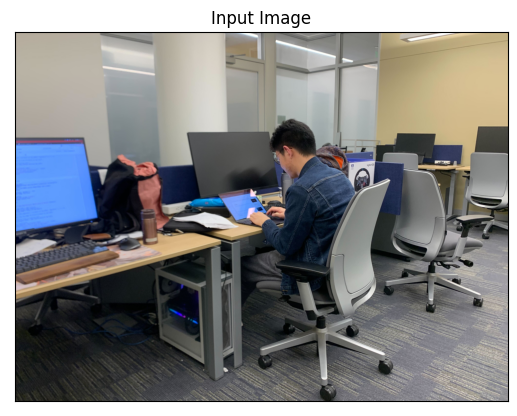

In [21]:
from PIL import Image
print(caps_feature_flat.shape)

def get_image_feat(img_path):
    image = CLIP_PREPROCESS(Image.open(img_path)).unsqueeze(0).to(CLIP_DEVICE)
    with torch.no_grad():
        img_features = CLIP_MODEL.encode_image(image).cpu().numpy()
    return img_features
    
def image_to_caption(img_path, method="l2",distance_metric="l2", k=5):
    plt.imshow(plt.imread(img_path))
    plt.xticks([])
    plt.yticks([])
    plt.title("Input Image")
    
    img_feat = get_image_feat(img_path)

    res = faiss_search(
        query=img_feat.astype('float32'), 
        database=caps_feature_flat, 
        k=k, 
        method=method,
        distance_metric=distance_metric
    )
    
    print("\n=== Img->Cap Retrivial Result Using {} Method".format(method))
    
    result_in_raw_index = res["result"]
    assert result_in_raw_index.shape[0] == 1
    result_in_raw_index = result_in_raw_index[0]

    for count, res_raw_index in enumerate(result_in_raw_index):
        # Original index in captions_feats
        # print("res_raw_index", res_raw_index)
        
        rew_original_index = caps_feature_keys[res_raw_index]
        
        # print("rew_original_index", rew_original_index)
    
        # cap_ids = coco.getAnnIds()
        anns = coco.loadAnns(int(rew_original_index))
        assert len(anns) == 1
        anns = anns[0]
        # print("\n")
        
        print("Img->Cap Retrivial {}/{}: Distance {:.3f}, Retrivial Caption:\n\t{}\n".format(
            count + 1, len(result_in_raw_index), 
            res["raw_distance"][0][count],
            anns["caption"]
        ))
    
        
image_to_caption("IMG_3240.jpg", method="pq", distance_metric="inner")

# Image to Tags

In [12]:
instance_features_flat = np.array(list(instance_features.values())).astype('float32')
instance_features_keys = list(instance_features.keys())


80 number of embeddings in the database using method: exact

=== Img->Instance Retrivial Result Using exact Method
{'result': array([[ 0, 63, 56, 24, 66]]), 'time': 0.0001452839933335781, 'raw_distance': array([[53.418835, 50.446465, 46.323772, 45.667633, 42.02847 ]],
      dtype=float32)}
person
53.418835


laptop
50.446465


chair
46.323772


backpack
45.667633


keyboard
42.02847


{'laptop', 'person', 'backpack', 'keyboard', 'chair'}


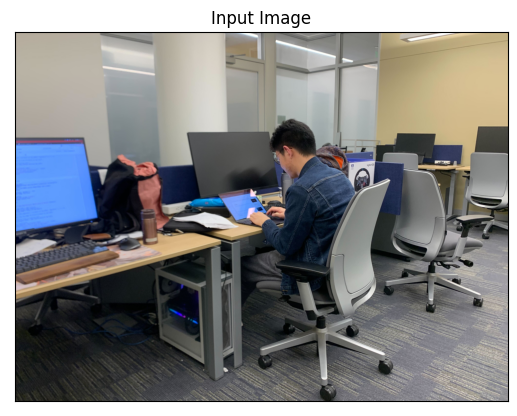

In [13]:


def get_instance_list(img_id):
    """This function is used to retrieve instance list"""
    
    anns = coco_instance.loadAnns(
        coco_instance.getAnnIds(imgIds=img_id)
    )
    # coco.showAnns(anns)
    ret = set([
        cat["name"] for cat in coco_instance.loadCats([a["category_id"] for a in anns])
    ])
    
    return ret


def image_to_instance(img_path, method="l2", distance="l2", k=5):
    plt.imshow(plt.imread(img_path))
    plt.xticks([])
    plt.yticks([])
    plt.title("Input Image")
    
    img_feat = get_image_feat(img_path)

    res = faiss_search(
        query=img_feat.astype('float32'), 
        database=instance_features_flat, 
        k=k, 
        method=method,
        n_partitions=5,
        distance_metric=distance,
    )
    
    print("\n=== Img->Instance Retrivial Result Using {} Method".format(method))
    
    result_in_raw_index = res["result"]
    assert result_in_raw_index.shape[0] == 1
    result_in_raw_index = result_in_raw_index[0]
    
    
    distance_list = res["raw_distance"][0]
    
    rew_original_indecies = [
        int(instance_features_keys[res_raw_index]) for res_raw_index in result_in_raw_index
    ]
    
#     print(rew_original_indecies)

    print(res)


    for i in range(len(distance_list)):
        print(coco_instance.loadCats(rew_original_indecies[i])[0]['name'])
        print(distance_list[i])
        print('\n')
    
    
    
    ret = set([
        cat["name"] for cat in coco_instance.loadCats(rew_original_indecies)
    ])
    
    print(ret)
    
    
image_to_instance("IMG_3240.jpg", method="exact", distance="inner", k=5)

# image_to_instance("000000000144.jpg", method="exact", distance="inner", k=5)

# Evaluation

In [14]:
from sklearn.metrics import ndcg_score
import numpy as np
import json

def eval_knn(true_values, predicted_scores, k):
    total_pre = []
    tp_sum = 0
    fp_sum = 0
    fn_sum = 0
    assert true_values.shape == predicted_scores.shape
    for count, (true_multi_hot, scores) in enumerate(zip(true_values, predicted_scores)):
        indices = scores.argsort()[-k:][::-1]
        predicted_multi_class = np.zeros_like(true_multi_hot, dtype=bool)
        predicted_multi_class[indices] = 1

        assert predicted_multi_class.shape == true_multi_hot.shape

        tp = np.logical_and(true_multi_hot, predicted_multi_class).sum()
        tp_sum += tp

        fp = np.logical_and(1 - true_multi_hot, predicted_multi_class).sum()
        fp_sum += fp

        fn = np.logical_and(true_multi_hot, 1 - predicted_multi_class).sum()
        fn_sum += fn
#         t("At data point {}, We have {} 1s in Pred and {} 1s in GT. TP{}, FP{}, FN{}".format(
    #             count, predicted_multi_class.sum(), true_multi_hot.sum(),
    #             tp, fp, fn
    #         ))
    #         print("At data point {}, We have {} 1s in Pred and {} 1s in GT. TP{}, FP{}, FN{}".format(
    #             count, predicted_multi_class.sum(), true_multi_hot.sum(),
    #             tp, fp, fn
    #         ))
        
    pre = tp_sum / (tp_sum + fp_sum)
    rec = tp_sum / (tp_sum + fn_sum)

    return {
        'precision@{}'.format(k): pre,
        "recall@{}".format(k): rec,
        "F1@{}".format(k): 2 * pre * rec / (pre + rec)
    }



## Image -> Instance Evaluation

In [41]:
num_classes = len(coco_instance.getCatIds())
num_images = len(coco.getImgIds())

ins_id_to_raw_index = {
    ins_id: raw_index for raw_index, ins_id in enumerate(instance_features_keys)
}

true_values = np.zeros((num_images, num_classes))

for img_count, img_id in enumerate(imgs_feature_keys):
    ins_ids = coco_instance.getAnnIds(imgIds=int(img_id))
    anns = coco_instance.loadAnns(ins_ids)
    
    for ann in anns:
        ins_id = ann["category_id"]
        raw_index = ins_id_to_raw_index[str(ins_id)]
        true_values[img_count, raw_index] = 1

num_output = num_classes

predicted_scores = np.zeros((num_images, num_output))

distance_metric = "l2"


k = 5

res = faiss_search(
        query=imgs_feature_flat.astype('float32'), 
        database=instance_features_flat, 
        k=k, 
        method="exact",
        distance_metric=distance_metric
)


for col_id, col in enumerate(res["result"]):
    predicted_scores[col_id, col] = 1
    
eval_knn(
    true_values=true_values,
    predicted_scores=predicted_scores,
    k=k
)


80 number of embeddings in the database using method: exact


{'precision@5': 0.1913887409436371,
 'recall@5': 0.33001551038496074,
 'F1@5': 0.2422736403222924}